# Gemstone Price Prediction

**Goal: To predict the gemstone price chart dataset with the Regression Model.**

In [1]:
import pandas as pd

         # Visulation
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

          # Regression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge,Lasso
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor, AdaBoostRegressor
from sklearn.tree import ExtraTreeRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

          # Modelling
from sklearn.model_selection import train_test_split

          # Error - Success
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error


    # Deep Learning
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense


import warnings
warnings.filterwarnings("ignore")

In [2]:
# Reading file

df = pd.read_csv("train.csv")
df_test = pd.read_csv("test.csv")

In [3]:
df.shape, df_test.shape

((193573, 11), (129050, 10))

In [4]:
data = df.append(df_test)

### EDA - Exploratory Data Analysis

	It is the process of understanding, exploring, and visualizing data. In this process, we will clean the data, characterize and perform statistical analysis, visualize the data and interpret the results.

In [5]:
data.head()

,id,carat,cut,color,clarity,depth,table,x,y,z,price
0,0,1.52,Premium,F,VS2,62.2,58.0,7.27,7.33,4.55,13619.0
1,1,2.03,Very Good,J,SI2,62.0,58.0,8.06,8.12,5.05,13387.0
2,2,0.70,Ideal,G,VS1,61.2,57.0,5.69,5.73,3.50,2772.0
3,3,0.32,Ideal,G,VS1,61.6,56.0,4.38,4.41,2.71,666.0
4,4,1.70,Premium,G,VS2,62.6,59.0,7.65,7.61,4.77,14453.0


In [6]:
data.columns

Index(['id', 'carat', 'cut', 'color', 'clarity', 'depth', 'table', 'x', 'y',
       'z', 'price'],
      dtype='object')

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 322623 entries, 0 to 129049
Data columns (total 11 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       322623 non-null  int64  
 1   carat    322623 non-null  float64
 2   cut      322623 non-null  object 
 3   color    322623 non-null  object 
 4   clarity  322623 non-null  object 
 5   depth    322623 non-null  float64
 6   table    322623 non-null  float64
 7   x        322623 non-null  float64
 8   y        322623 non-null  float64
 9   z        322623 non-null  float64
 10  price    193573 non-null  float64
dtypes: float64(7), int64(1), object(3)
memory usage: 29.5+ MB


In [8]:
data.isnull().sum()

id              0
carat           0
cut             0
color           0
clarity         0
depth           0
table           0
x               0
y               0
z               0
price      129050
dtype: int64

		- There are no empty columns.

### Feature Engineering 

	- It is the process of creating new features using existing features in the data set. In this process, existing features 	are manipulated or combined to make the data more meaningful, improve model performance and achieve better results.

In [9]:
data["cut"].unique()

array(['Premium', 'Very Good', 'Ideal', 'Good', 'Fair'], dtype=object)

 - The content of the columns has features that favour each other. It is sorted according to these features and converted into numbers.   

In [10]:
d = {'Premium':5, 'Very Good':4, 'Ideal':3, 'Good':2, 'Fair':1}
data["cut"]=data["cut"].map(d)
data["cut"].unique()

array([5, 4, 3, 2, 1], dtype=int64)

In [11]:
data["clarity"].unique()

array(['VS2', 'SI2', 'VS1', 'SI1', 'IF', 'VVS2', 'VVS1', 'I1'],
      dtype=object)

 - Changed the column names. Because x, y and z are length, width and height. 

In [13]:
data=data.rename(columns={'x':'length','y':'width','z':'height'})

In [14]:
data = data.drop('id',axis=1)
data.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'length', 'width',
       'height', 'price'],
      dtype='object')

In [15]:
data.isnull().sum()

carat           0
cut             0
color           0
clarity         0
depth           0
table           0
length          0
width           0
height          0
price      129050
dtype: int64

In [16]:
abs(data.corr()["price"]).sort_values(ascending=True)

depth     0.001880
cut       0.111462
table     0.174915
height    0.893037
length    0.901004
width     0.901033
carat     0.943396
price     1.000000
Name: price, dtype: float64

In [17]:
data.corr()

,carat,cut,depth,table,length,width,height,price
carat,1.000000,0.127494,0.026491,0.225726,0.980528,0.980089,0.972880,0.943396
cut,0.127494,1.000000,-0.256004,0.429969,0.134686,0.128101,0.105916,0.111462
depth,0.026491,-0.256004,1.000000,-0.233942,-0.011967,-0.012801,0.080541,0.001880
table,0.225726,0.429969,-0.233942,1.000000,0.237945,0.233617,0.211627,0.174915
length,0.980528,0.134686,-0.011967,0.237945,1.000000,0.999126,0.988376,0.901004
width,0.980089,0.128101,-0.012801,0.233617,0.999126,1.000000,0.988223,0.901033
height,0.972880,0.105916,0.080541,0.211627,0.988376,0.988223,1.000000,0.893037
price,0.943396,0.111462,0.001880,0.174915,0.901004,0.901033,0.893037,1.000000


### Visualization

<Axes: xlabel='cut', ylabel='count'>

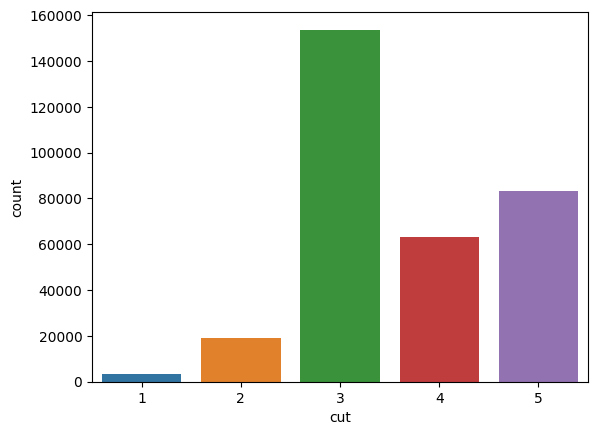

In [18]:
sns.countplot(x=data["cut"])

<Axes: xlabel='carat', ylabel='count'>

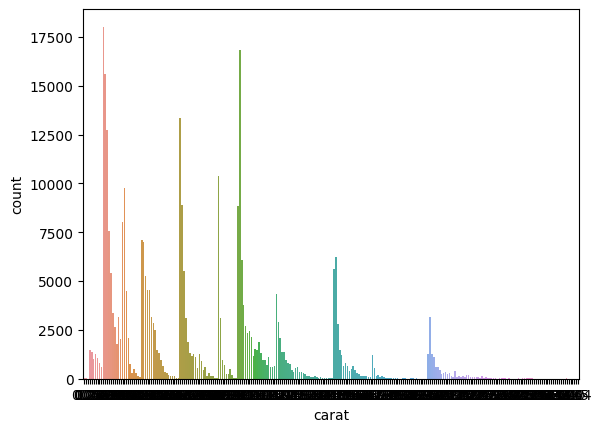

In [19]:
sns.countplot(x=data["carat"])

<Axes: xlabel='table', ylabel='count'>

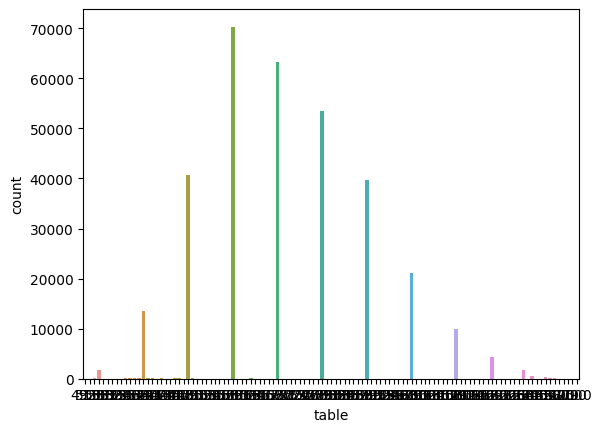

In [20]:
sns.countplot(x=data["table"])

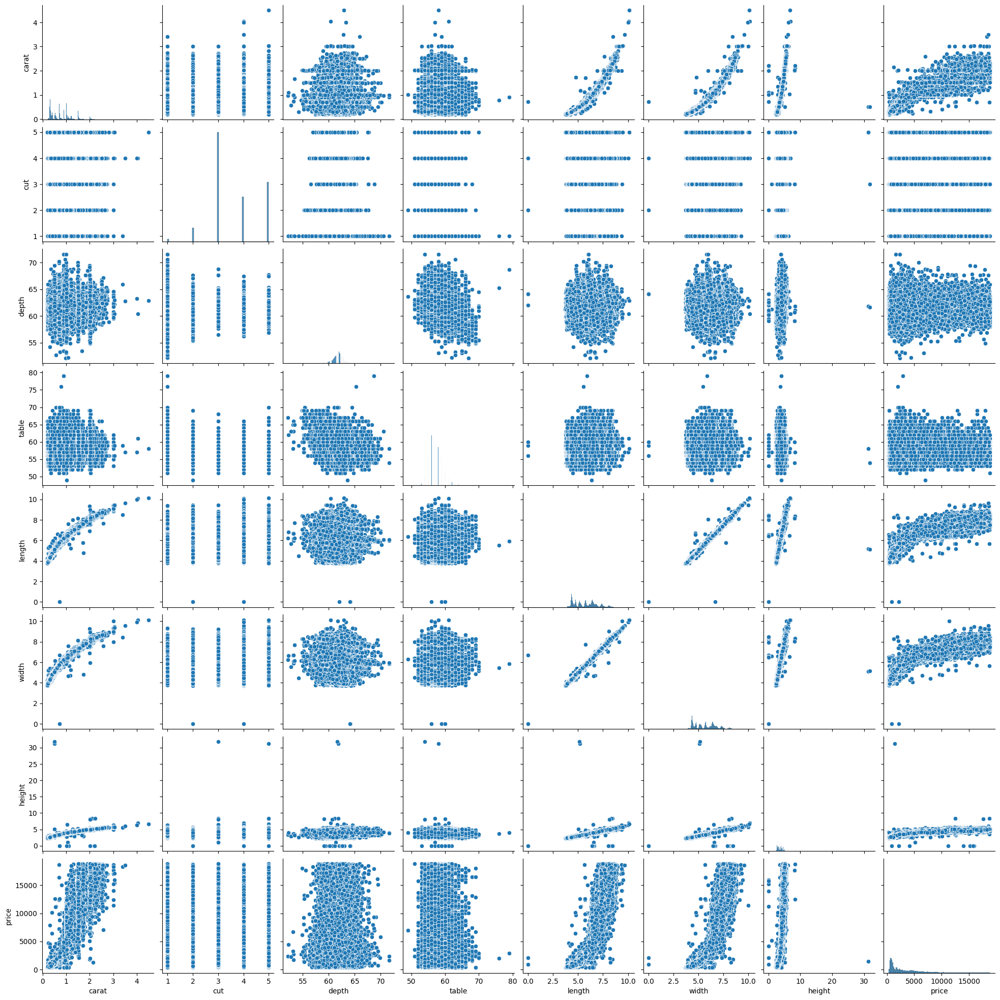

In [21]:
sns.pairplot(data)

In [22]:
figure = px.scatter(data_frame = df, x="price", y="carat", size="carat", trendline="ols")
figure.show()

<Axes: >

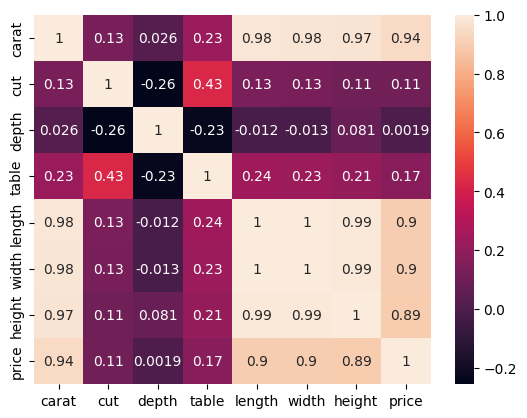

In [23]:
sns.heatmap(data.corr(), annot=True)

### Modelling - With Sklearn

 - In fact, one of the most important parts of the regression section is the **get_dummies()** method. Because it converts columns with column type object to matrix without specifying any superiority.

In [24]:
data = pd.get_dummies(data,drop_first=True)

 - The merged data is again divided into test and train.

In [25]:
train = data[:193573]
test = data[193573:]

In [26]:
x = train.drop("price",axis=1)
y =train["price"]

In [27]:
# A new function including all Regression models is created.
# We can see R_Squared, RMSE and MAE of all Regression Models

def algo_test(x,y):
    L = LinearRegression()
    R = Ridge()
    Lass = Lasso()
    E = ElasticNet()
    ETR = ExtraTreeRegressor()
    GBR = GradientBoostingRegressor()
    ADA = AdaBoostRegressor()
    RND = RandomForestRegressor()
    DTR = DecisionTreeRegressor()
    
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.2, random_state=42)
    
    algos=[L,R,Lass,E,ETR,GBR,ADA,RND,DTR]
    algo_names=['Linear','Ridge','Lasso','ElasticNet','Extra Tree','Gradient Boosting','Ada Boost','Decision Tree','Random Forest']
        
    r_squared= []
    rmse= []
    mae= []
    
    result=pd.DataFrame(columns=['R_Squared','RMSE','MAE'],index=algo_names)
    
    for algo in algos:
        p=algo.fit(x_train,y_train).predict(x_test)
        r_squared.append(r2_score(y_test,p))
        rmse.append(mean_squared_error(y_test,p)**.5)
        mae.append(mean_absolute_error(y_test,p))
        
    result.R_Squared=r_squared
    result.RMSE=rmse
    result.MAE=mae
    return result.sort_values('R_Squared',ascending=False)

In [28]:
# Testing Regression Models

algo_test(x,y)

,R_Squared,RMSE,MAE
Gradient Boosting,0.968894,708.987152,379.173063
Extra Tree,0.955363,849.302032,424.185208
Linear,0.944589,946.266859,623.622212
Ridge,0.944589,946.267364,623.621900
Lasso,0.944040,950.937459,623.170070
ElasticNet,0.812809,1739.233148,1202.903806


In [29]:
# Gradient Boosting chosen because of Best model.

gboost = GradientBoostingRegressor()
model = gboost.fit(x,y)
guess = model.predict(test.drop("price",axis=1))

In [30]:
# New DataFrame created for Submission.

result = pd.DataFrame()

In [31]:
result["id"] = df_test["id"]
result["price"] = guess

In [32]:
result

,id,price
0,193573,864.384698
1,193574,2655.578716
2,193575,2349.358189
3,193576,875.921748
4,193577,6313.491162
...,...,...
129045,322618,3345.516773
129046,322619,2413.985538
129047,322620,7927.191052
129048,322621,9270.800814


In [33]:
result.to_csv("submission.csv",index=False)

### With Deep Learning - Tensorflow/Keras

In [34]:
x = train.drop("price",axis=1)
y =train["price"]

In [35]:
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.2, random_state=42)

In [36]:
model = Sequential()
model.add(Dense(512,activation="relu"))
model.add(Dense(256,activation="relu"))
model.add(Dense(128,activation="relu"))
model.add(Dense(64,activation="relu"))
model.add(Dense(32,activation="relu"))
model.add(Dense(16,activation="relu"))
model.add(Dense(256,activation="relu"))
model.add(Dense(128,activation="relu"))
model.add(Dense(64,activation="relu"))
model.add(Dense(8,activation="relu"))
model.add(Dense(1))
model.compile(loss="mse", optimizer="adam")
history = model.fit(x_train,y_train, validation_data=(x_test,y_test), epochs=100, batch_size=128, verbose=1)

Epoch 1/100
1210/1210 [==============================] - 8s 5ms/step - loss: 3205192.0000 - val_loss: 543458.1250
Epoch 2/100
1210/1210 [==============================] - 6s 5ms/step - loss: 603836.7500 - val_loss: 586208.1875
Epoch 3/100
1210/1210 [==============================] - 4s 4ms/step - loss: 584539.1875 - val_loss: 478517.1250
Epoch 4/100
1210/1210 [==============================] - 7s 5ms/step - loss: 532998.5625 - val_loss: 504199.2812
Epoch 5/100
1210/1210 [==============================] - 5s 4ms/step - loss: 526680.5625 - val_loss: 507031.7500
Epoch 6/100
1210/1210 [==============================] - 6s 5ms/step - loss: 498199.4688 - val_loss: 426620.2500
Epoch 7/100
1210/1210 [==============================] - 7s 6ms/step - loss: 474502.7812 - val_loss: 423130.2188
Epoch 8/100
1210/1210 [==============================] - 5s 4ms/step - loss: 458585.2500 - val_loss: 415092.2812
Epoch 9/100
1210/1210 [==============================] - 8s 6ms/step - loss: 452288.3438 - val_

Epoch 73/100
1210/1210 [==============================] - 6s 5ms/step - loss: 363281.3125 - val_loss: 354290.6562
Epoch 74/100
1210/1210 [==============================] - 6s 5ms/step - loss: 366439.4375 - val_loss: 343207.8125
Epoch 75/100
1210/1210 [==============================] - 6s 5ms/step - loss: 365059.8125 - val_loss: 353143.0000
Epoch 76/100
1210/1210 [==============================] - 6s 5ms/step - loss: 365455.3438 - val_loss: 347208.0000
Epoch 77/100
1210/1210 [==============================] - 9s 8ms/step - loss: 364804.8438 - val_loss: 351277.9375
Epoch 78/100
1210/1210 [==============================] - 6s 5ms/step - loss: 362245.7188 - val_loss: 367948.3438
Epoch 79/100
1210/1210 [==============================] - 10s 8ms/step - loss: 365009.6250 - val_loss: 339578.2812
Epoch 80/100
1210/1210 [==============================] - 6s 5ms/step - loss: 361451.3750 - val_loss: 355656.9688
Epoch 81/100
1210/1210 [==============================] - 10s 8ms/step - loss: 362053.2

In [37]:
guess = model.predict(x_test)
r2_score(guess,y_test)

1210/1210 [==============================] - 3s 2ms/step


0.9740383840203272

In [38]:
(mean_squared_error(y_test, guess))**0.5

676.5387130261635

<Axes: >

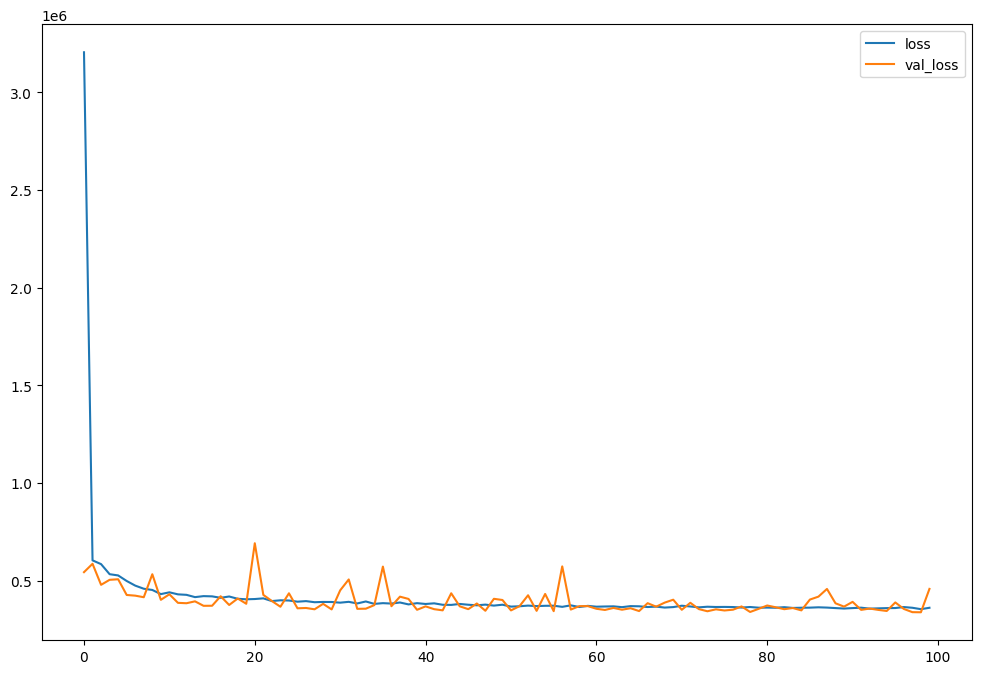

In [39]:
loss_df = pd.DataFrame(history.history)
loss_df.plot(figsize=(12,8))

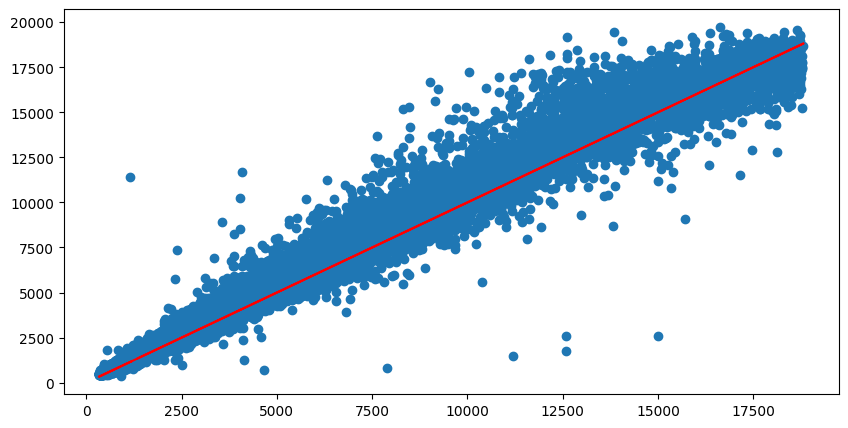

In [40]:
fig = plt.figure(figsize=(10,5))
plt.scatter(y_test,guess)
plt.plot(y_test,y_test,'r')

In [42]:
# Use the model to make price predictions on the test data
predicted_prices = model.predict(x_test)

# Convert the predicted prices to a pandas DataFrame and add an "id" column
results_df = pd.DataFrame(predicted_prices, columns=["Price"])
results_df["id"] = df_test["id"]

# Rename the "id" column to "Id" and write the results to a CSV file
results_df = results_df.rename(columns={"id": "Id"})
results_df.to_csv("predicted_prices.csv", index=False)


1210/1210 [==============================] - 2s 2ms/step
